# Analysis

Re-rethinking the causes of deforestation: does the theory evolve? by Desra Arriyadi

# Load data and preparation

## Environment setup


This section sets up the Python environment by importing essential libraries like pandas, numpy, sklearn, and other libraries.

Packages like wbgapi (for accessing World Bank data) and geoviews (for geospatial visualization) are installed to handle data processing and visualization tasks.

In [1]:
%%capture
from google.colab import drive
drive.mount('/content/drive')

In [2]:
%%capture
%cd /content/drive/MyDrive/Colab Notebooks

In [3]:
!pip install --quiet wbgapi
!pip install --quiet hvplot
!pip install --quiet geoviews cartopy

In [4]:
import wbgapi as wb
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
import altair as alt
import requests
import folium
from folium import Choropleth
import holoviews as hv
import hvplot.pandas
from vega_datasets import data

# Models
from sklearn.ensemble import RandomForestRegressor

# Model selection
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score

# Pre-Processing
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler

# Pipelines
from sklearn.pipeline import make_pipeline

# Metrics
from sklearn.metrics import recall_score, r2_score

pd.set_option('display.max_columns',500)
pd.set_option('display.max_rows', 100)
hv.extension("bokeh")

## Data loading



Filter out non-country entities (like regions or continents) from the World Bank data. The allCountry DataFrame initially includes all entities, but only rows with valid country-level data are retained by dropping NaN values and extracting the country id into allCountryList.

In [5]:
# Select only ID countries by excluding region/group/etc
allCountry = wb.economy.DataFrame()
allCountryList = allCountry.dropna().reset_index()['id'].tolist()

Data is retrieved for specific variables relevant to deforestation, such as forest area, agricultural land, economy, and other variables.



In [6]:
allVariables =['AG.LND.AGRI.K2',
'AG.LND.FRST.ZS',
'AG.LND.AGRI.ZS',
'AG.LND.ARBL.HA',
'AG.LND.CROP.ZS',
'AG.LND.FRST.K2',
'AG.LND.TOTL.UR.K2',
'AG.PRD.CREL.MT',
'AG.PRD.CROP.XD',
'EG.USE.COMM.FO.ZS',
'EG.USE.PCAP.KG.OE',
'EN.POP.DNST',
'GE.EST',
'NV.AGR.TOTL.ZS',
'NY.ADJ.DFOR.CD',
'NY.GDP.FRST.RT.ZS',
'NY.GDP.MKTP.KD.ZG',
'PV.EST',
'RQ.EST',
'SE.ADT.LITR.ZS',
'SE.PRM.ENRR',
'SE.SEC.ENRR',
'SH.STA.MALN.ZS',
'SI.POV.DDAY',
'SI.POV.GINI',
'SL.AGR.0714.ZS',
'SL.AGR.EMPL.ZS',
'SL.EMP.SELF.ZS',
'SL.TLF.TOTL.IN',
'SN.ITK.DEFC.ZS',
'SP.POP.GROW',
'SP.POP.TOTL',
'SP.RUR.TOTL',
'SP.RUR.TOTL.ZG',
'SP.RUR.TOTL.ZS',
'SP.URB.GROW',
'SP.URB.TOTL.IN.ZS',
'TM.VAL.AGRI.ZS.UN',
'TM.VAL.MRCH.XD.WD',
'TX.VAL.AGRI.ZS.UN',
'VC.IDP.TOCV',
'AG.CON.FERT.PT.ZS',
'AG.LND.TOTL.RU.K2',
'BG.GSR.NFSV.GD.ZS',
'BM.GSR.FCTY.CD',
'BM.GSR.TRVL.ZS',
'BX.GSR.GNFS.CD',
'CC.EST',
'CM.MKT.LCAP.CD',
'DT.DOD.DECT.CD',
'DT.DOD.DIMF.CD',
'DT.TDS.DECT.CD',
'DT.TDS.MLAT.CD',
'FB.CBK.BRWR.P3',
'FM.AST.DOMS.CN',
'FM.AST.NFRG.CN',
'FP.CPI.TOTL',
'GC.TAX.EXPT.CN',
'GC.TAX.GSRV.CN',
'GC.TAX.INTT.CN',
'GC.XPN.TRFT.CN',
'HD.HCI.OVRL',
'IS.RRS.TOTL.KM',
'LP.EXP.DURS.MD',
'NY.GDP.MKTP.CD'
]

This function process_wb_variables retrieves and processes data from the World Bank API for a list of variables, countries, and years.

Purpose: Fetch data for specified variables and merge into a single DataFrame for analysis. Process includes data for each variable is fetched and cleaned (resetting index, renaming columns, filtering by countries, and restructuring into long format). Years are standardized as integers. Each variable's data is stored in a list. All variables' data are merged into a single DataFrame by country, year, and ID. Error Handling: Logs errors for individual variables and raises an exception if no data is successfully processed. Output: Returns a comprehensive DataFrame (wbData) containing aligned data for all variables, countries, and years.



In [7]:
# Note: range start year to end year-1
def process_wb_variables(variables, allCountryList, time_range=range(2000, 2024)):
    # List to store processed dataframes
    processed_dfs = []

    # Process each variable
    for variable in variables:
        try:
            # Fetch data
            dfGetData = wb.data.DataFrame(variable, time=time_range, labels=True)

            # Reset the index to make 'economy' and 'economy_label' as columns
            dfGetData = dfGetData.reset_index()

            # Rename the columns
            dfGetData = dfGetData.rename(columns={
                'economy': 'ID',
                dfGetData.columns[1]: 'Country'
            })

            # Filter countries
            dfGetData = dfGetData[dfGetData['ID'].isin(allCountryList)]

            # Melt the DataFrame
            melted_df = dfGetData.melt(
                id_vars=['ID', 'Country'],
                var_name='year',
                value_name=variable  # Use variable code as value column name
            )

            # Convert year to integer
            melted_df['year'] = melted_df['year'].astype(str).str.replace('YR', '').astype(int)

            # Sort and add to list
            melted_df = melted_df.sort_values(['ID', 'year'])

            processed_dfs.append(melted_df)

            #print(f"Processed {variable} successfully")

        except Exception as e:
            print(f"Error processing {variable}: {e}")

    # Merge all processed dataframes
    if processed_dfs:
        # Merge on ID, Country, and year
        merged_df = processed_dfs[0]
        for dfGetData in processed_dfs[1:]:
            merged_df = pd.merge(merged_df, dfGetData, on=['ID', 'Country', 'year'], how='outer')

        return merged_df
    else:
        raise ValueError("No variables could be processed")

# Process all variables
wbData = process_wb_variables(allVariables, allCountryList)

In [8]:
wbData.round(1)

,ID,Country,year,AG.LND.AGRI.K2,AG.LND.FRST.ZS,AG.LND.AGRI.ZS,AG.LND.ARBL.HA,AG.LND.CROP.ZS,AG.LND.FRST.K2,AG.LND.TOTL.UR.K2,AG.PRD.CREL.MT,AG.PRD.CROP.XD,EG.USE.COMM.FO.ZS,EG.USE.PCAP.KG.OE,EN.POP.DNST,GE.EST,NV.AGR.TOTL.ZS,NY.ADJ.DFOR.CD,NY.GDP.FRST.RT.ZS,NY.GDP.MKTP.KD.ZG,PV.EST,RQ.EST,SE.ADT.LITR.ZS,SE.PRM.ENRR,SE.SEC.ENRR,SH.STA.MALN.ZS,SI.POV.DDAY,SI.POV.GINI,SL.AGR.0714.ZS,SL.AGR.EMPL.ZS,SL.EMP.SELF.ZS,SL.TLF.TOTL.IN,SN.ITK.DEFC.ZS,SP.POP.GROW,SP.POP.TOTL,SP.RUR.TOTL,SP.RUR.TOTL.ZG,SP.RUR.TOTL.ZS,SP.URB.GROW,SP.URB.TOTL.IN.ZS,TM.VAL.AGRI.ZS.UN,TM.VAL.MRCH.XD.WD,TX.VAL.AGRI.ZS.UN,VC.IDP.TOCV,AG.CON.FERT.PT.ZS,AG.LND.TOTL.RU.K2,BG.GSR.NFSV.GD.ZS,BM.GSR.FCTY.CD,BM.GSR.TRVL.ZS,BX.GSR.GNFS.CD,CC.EST,CM.MKT.LCAP.CD,DT.DOD.DECT.CD,DT.DOD.DIMF.CD,DT.TDS.DECT.CD,DT.TDS.MLAT.CD,FB.CBK.BRWR.P3,FM.AST.DOMS.CN,FM.AST.NFRG.CN,FP.CPI.TOTL,GC.TAX.EXPT.CN,GC.TAX.GSRV.CN,GC.TAX.INTT.CN,GC.XPN.TRFT.CN,HD.HCI.OVRL,IS.RRS.TOTL.KM,LP.EXP.DURS.MD,NY.GDP.MKTP.CD
0,ABW,Aruba,2000,20.0,2.3,11.1,2000.0,NaN,4.2,87.4,NaN,NaN,NaN,NaN,503.3,NaN,0.0,13173.8,0.0,7.6,NaN,NaN,97.0,108.3,93.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,90588.0,48268.0,1.8,53.3,0.2,46.7,2.9,206.5,0.7,NaN,NaN,94.8,119.0,77016759.8,22.6,1.815620e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.478961e+09,5.541720e+08,72.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.873453e+09
1,ABW,Aruba,2001,20.0,2.3,11.1,2000.0,NaN,4.2,NaN,NaN,NaN,NaN,NaN,508.0,NaN,0.0,13673.8,0.0,4.2,NaN,NaN,NaN,110.9,95.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.9,91439.0,49067.0,1.6,53.7,0.1,46.3,2.5,189.7,0.5,NaN,NaN,NaN,128.6,107083798.9,21.9,2.018207e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.540655e+09,7.006010e+08,74.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.896457e+09
2,ABW,Aruba,2002,20.0,2.3,11.1,2000.0,NaN,4.2,NaN,NaN,NaN,NaN,NaN,511.5,NaN,0.0,12759.1,0.0,-0.9,NaN,NaN,NaN,115.3,100.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.7,92074.0,49746.0,1.4,54.0,-0.1,46.0,2.5,161.3,1.0,NaN,NaN,NaN,93.7,167910614.5,26.0,1.448782e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.706137e+09,7.469060e+08,76.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.961844e+09
3,ABW,Aruba,2003,20.0,2.3,11.1,2000.0,NaN,4.2,NaN,NaN,NaN,NaN,NaN,517.4,NaN,0.0,14148.0,0.0,1.1,NaN,NaN,NaN,113.9,99.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.1,93128.0,50656.0,1.8,54.4,0.3,45.6,2.7,191.7,1.2,NaN,NaN,NaN,114.2,85882681.6,25.8,1.766140e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.969561e+09,7.009150e+08,79.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.044112e+09
4,ABW,Aruba,2004,20.0,2.3,11.1,2000.0,NaN,4.2,NaN,NaN,NaN,NaN,NaN,528.5,1.3,0.0,15276.3,0.0,7.3,1.0,0.8,NaN,116.2,97.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.1,95138.0,52098.0,2.8,54.8,1.3,45.2,2.8,287.0,1.2,NaN,NaN,NaN,84.2,109927374.3,33.8,4.687899e+09,1.2,NaN,NaN,NaN,NaN,NaN,NaN,2.061564e+09,7.227750e+08,81.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.254831e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5059,ZWE,Zimbabwe,2019,162000.0,45.2,39.5,4000000.0,0.1,174906.5,NaN,1026006.4,104.3,NaN,NaN,39.5,-1.3,9.8,435782762.1,2.0,-6.3,-0.9,-1.5,93.2,97.5,NaN,9.7,39.8,50.3,NaN,62.4,70.9,5772798.0,39.4,1.6,15271368.0,10352460.0,1.6,67.8,1.6,32.2,0.4,79.6,2.2,NaN,623.5,NaN,5.9,354325147.1,22.4,5.266937e+09,-1.3,NaN,1.224936e+10,4.681985e+08,1.597240e+09,16177509.3,85.1,2.766927e+10,-4.066235e+10,414.7,NaN,NaN,NaN,NaN,NaN,3120.0,NaN,2.571741e+10
5060,ZWE,Zimbabwe,2020,162000.0,45.1,39.8,4000000.0,0.2,174445.8,NaN,1660964.0,127.8,NaN,NaN,40.1,-1.3,8.8,487068344.4,2.3,-7.8,-1.1,-1.4,NaN,97.4,NaN,NaN,NaN,NaN,NaN,58.8,67.8,5842807.0,39.5,1.7,15526888.0,10520709.0,1.6,67.8,1.8,32.2,0.3,82.6,1.7,NaN,212.5,NaN,4.1,480586954.8,17.6,5.263295e+09,-1.3,NaN,1.274203e+10,4.876475e+08,9.846859e+08,9135529.1,54.1,1.066966e+11,-3.353351e+11,2725.3,NaN,NaN,NaN,NaN,0.5,3120.0,NaN,2.686794e+10
5061,ZWE,Zimbabwe,2021,162000.0,45.0,39.4,4000000.0,0.2,173985.1,NaN,2043436.4,130.0,NaN,NaN,40.8,-1.3,8.8,516326002.5,1.8,8.5,-



Create a DataFrame codeDescription that maps World Bank variable codes to their human-readable descriptions, making the data easier to interpret. The DataFrame contains two columns: Variable (the code) and Description (its explanation).

The output of this cell is referenced multiple times in subsequent processes to provide clear, descriptive labels for the variables used in the analysis.

In [9]:
codeDescription = pd.DataFrame(wb.series.info().table(), columns=['Variable', 'Description'])
codeDescription

,Variable,Description
0,AG.CON.FERT.PT.ZS,Fertilizer consumption (% of fertilizer produc...
1,AG.CON.FERT.ZS,Fertilizer consumption (kilograms per hectare ...
2,AG.LND.AGRI.K2,Agricultural land (sq. km)
3,AG.LND.AGRI.ZS,Agricultural land (% of land area)
4,AG.LND.ARBL.HA,Arable land (hectares)
...,...,...
1492,VC.IDP.TOCV,"Internally displaced persons, total displaced ..."
1493,VC.IHR.PSRC.FE.P5,"Intentional homicides, female (per 100,000 fem..."
1494,VC.IHR.PSRC.MA.P5,"Intentional homicides, male (per 100,000 male)"
1495,VC.IHR.PSRC.P5,"Intentional homicides (per 100,000 people)"


### Visualization of all World Bank Data

Reshape the dataset from wide to long format using pd.melt, where variables are listed under a Variable column, and their corresponding values are placed in a Value column. Essential identifiers like ID, Country, and year are retained, while all other columns are melted. The reshaped data is then grouped by ID, Country, and Variable to calculate the average value of each variable across all years, resulting in two DataFrames: wbData_melted for detailed analysis and wbAverageValue for summarizing variable averages by country.

In [10]:
columns_to_keep = ["ID", "Country", "year"]
data_columns = wbData.columns.difference(columns_to_keep)

# Use pd.melt to reshape the data
wbData_melted = pd.melt(
    wbData,
    id_vars=columns_to_keep,
    value_vars=data_columns,
    var_name="Variable",
    value_name="Value"
)

# Calculate the average Value based on year
wbAverageValue = wbData_melted.groupby(['ID','Country', 'Variable'])['Value'].mean().reset_index()

Fetch Country Boundaries: A GeoJSON file containing country boundary data is retrieved from the Natural Earth GeoServer. The requests library is used to fetch the data, and it is converted into a GeoDataFrame (world) using geopandas.

In [11]:
# Get country boundaries from Natural Earth GeoServer
url = "https://raw.githubusercontent.com/nvkelso/natural-earth-vector/master/geojson/ne_110m_admin_0_countries.geojson"
response = requests.get(url, headers={"Accept": "application/json"})
geojson_data = response.json()
world = gpd.GeoDataFrame.from_features(geojson_data["features"])

The GeoDataFrame (world) is merged with the previously cleaned World Bank data (wbAverageValue) based on the matching country IDs (WB_A3 from the GeoServer and ID from the cleaned data). This creates a GeoDataFrame (wbDataGeo) that combines spatial and non-spatial data for each country.
The merged GeoDataFrame retains only necessary columns: geometry (spatial information for mapping), Country, Variable (World Bank variable), and Value (its average value).

In [12]:
# Merge the GeoDataFrame with Natural Earth GeoServer data
wbDataGeo = world.merge(wbAverageValue, left_on='WB_A3', right_on='ID', how='inner')

# Keep only the geometry column
wbDataGeo = wbDataGeo[["geometry", "Country", "Variable", "Value"]]

A copy of the merged GeoDataFrame (wbDataGeoCopy) is created and enriched by merging with the codeDescription DataFrame to add human-readable descriptions for each variable. Values are rounded for clearer presentation.

In [13]:
# Create dataframe for visualization
wbDataGeoCopy = wbDataGeo.copy()
wbDataGeoVis = pd.merge(wbDataGeoCopy, codeDescription, on='Variable')
wbDataGeoVis['Value'] = wbDataGeoVis['Value'].round(2)
wbDataGeoVis.round(1)

,geometry,Country,Variable,Value,Description
0,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",Fiji,AG.CON.FERT.PT.ZS,NaN,Fertilizer consumption (% of fertilizer produc...
1,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",Fiji,AG.LND.AGRI.K2,3290.9,Agricultural land (sq. km)
2,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",Fiji,AG.LND.AGRI.ZS,18.0,Agricultural land (% of land area)
3,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",Fiji,AG.LND.ARBL.HA,79263.6,Arable land (hectares)
4,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",Fiji,AG.LND.CROP.ZS,4.2,Permanent cropland (% of land area)
...,...,...,...,...,...
10655,"POLYGON ((30.83385 3.50917, 29.9535 4.1737, 29...",South Sudan,SP.URB.TOTL.IN.ZS,18.4,Urban population (% of total population)
10656,"POLYGON ((30.83385 3.50917, 29.9535 4.1737, 29...",South Sudan,TM.VAL.AGRI.ZS.UN,NaN,Agricultural raw materials imports (% of merch...
10657,"POLYGON ((30.83385 3.50917, 29.9535 4.1737, 29...",South Sudan,TM.VAL.MRCH.XD.WD,NaN,Import value index (2015 = 100)
10658,"POLYGON ((30.83385 3.50917, 29.9535 4.1737, 29...",South Sudan,TX.VAL.AGRI.ZS.UN,NaN,Agricultural raw materials exports (% of merch...


Create an interactive geospatial map using hvplot to visualize World Bank data across countries. The map displays variable values (Value) with color gradients (cmap='plasma') on a dark background (tiles='CartoDark') and allows users to switch between variables using a dropdown menu (groupby='Description'). Hover functionality reveals country names and values, and the map is styled with a minimal dark theme for clarity.

In [14]:
# Boundary
x_rangemap = (-180, 180)
y_rangemap = (-90, 90)

# Create map
img = wbDataGeoVis.hvplot(
    geo=True,
    dynamic=False,
    tiles='CartoDark',
    frame_width=400,
    frame_height=400,
    c='Value',
    groupby='Description',
    cmap='plasma',
    hover_cols=['Country', 'Value'],
    xlim=x_rangemap,
    ylim=y_rangemap
)

hv.renderer('bokeh').theme = 'dark_minimal'
img

:HoloMap   [Description]
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .Polygons.I :Polygons   [Longitude,Latitude]   (Value,Country)

### Visualization of Missing Data:


Generate a heatmap to visualize missing values in the dataset, sorted by columns and countries. It calculates the number of NaN values per column and country, reorders the data accordingly, and creates a binary DataFrame (NaN vs. non-NaN) for the heatmap. The plot uses color coding (blue for NaN and green for valid data) to highlight patterns of missing data, helping in understanding the extent of missing data and deciding on the cleaning strategy.

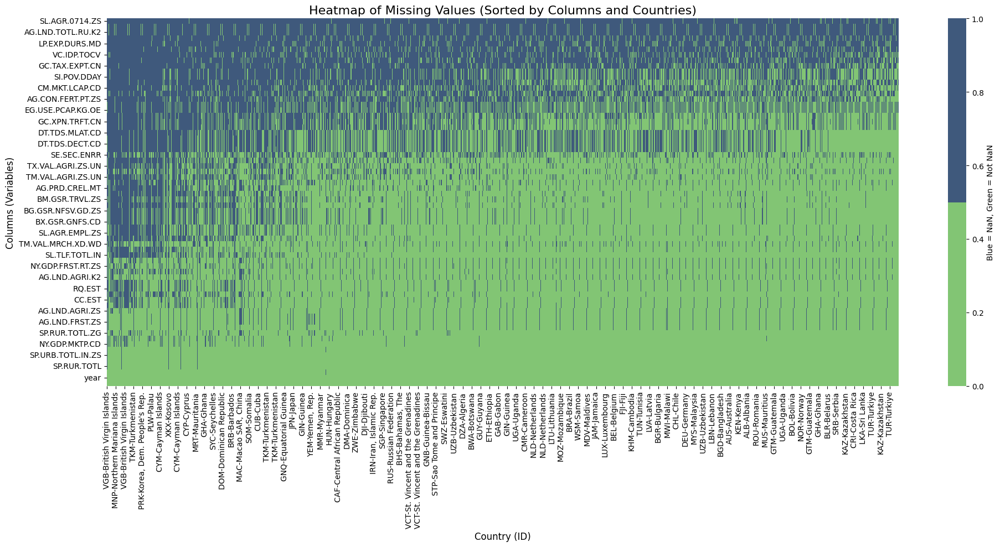

In [15]:
# Recalculate the number of NaN values per column and per country
hmColumnSort = wbData.isna().sum().sort_values(ascending=False)
hmCountrySort = wbData.set_index(['ID', 'Country']).isna().sum(axis=1).sort_values(ascending=False)

# Reorder the DataFrame based on sorted NaN counts
hmSort = wbData[hmColumnSort.index]

# Reorder the countries based on their NaN counts
hmSort = hmSort.set_index(['ID', 'Country']).loc[hmCountrySort.index]

# Create a DataFrame indicating NaN values for the heatmap
hmBothSort = hmSort.isna()

# Plotting the heatmap
plt.figure(figsize=(20, 10))
sns.heatmap(
    hmBothSort.T,
    cmap=['#82C574', '#3F597C'],
    cbar=True,
    cbar_kws={'label': 'Blue = NaN, Green = Not NaN'}
)

plt.title('Heatmap of Missing Values (Sorted by Columns and Countries)', fontsize=16)
plt.xlabel('Country (ID)', fontsize=12)
plt.ylabel('Columns (Variables)', fontsize=12)
plt.tight_layout()
plt.show()

# Pre-processing

## Missing data



Missing values are handled using a threshold to remove columns or rows with excessive missing data.

Missing values (NaN) in each column are counted and sorted in descending order to identify variables with the most missing data.

In [16]:
# Display NaN data each column
nan_counts = wbData.isna().sum().sort_values(ascending=False)

Columns where missing values exceed half the total number of rows are removed (columns_to_drop), as they lack sufficient data for meaningful analysis.

In [17]:
# Drop columns NaN
halfWbDataNan = len(wbData) / 2
columns_to_drop = nan_counts[nan_counts >= halfWbDataNan].index
wbDataDropColumns = wbData.drop(columns=columns_to_drop)
wbDataDropColumns.round(1)

,ID,Country,year,AG.LND.AGRI.K2,AG.LND.FRST.ZS,AG.LND.AGRI.ZS,AG.LND.ARBL.HA,AG.LND.CROP.ZS,AG.LND.FRST.K2,AG.PRD.CREL.MT,AG.PRD.CROP.XD,EN.POP.DNST,GE.EST,NV.AGR.TOTL.ZS,NY.ADJ.DFOR.CD,NY.GDP.FRST.RT.ZS,NY.GDP.MKTP.KD.ZG,PV.EST,RQ.EST,SE.PRM.ENRR,SE.SEC.ENRR,SL.AGR.EMPL.ZS,SL.EMP.SELF.ZS,SL.TLF.TOTL.IN,SN.ITK.DEFC.ZS,SP.POP.GROW,SP.POP.TOTL,SP.RUR.TOTL,SP.RUR.TOTL.ZG,SP.RUR.TOTL.ZS,SP.URB.GROW,SP.URB.TOTL.IN.ZS,TM.VAL.AGRI.ZS.UN,TM.VAL.MRCH.XD.WD,TX.VAL.AGRI.ZS.UN,BG.GSR.NFSV.GD.ZS,BM.GSR.FCTY.CD,BM.GSR.TRVL.ZS,BX.GSR.GNFS.CD,CC.EST,DT.DOD.DECT.CD,DT.DOD.DIMF.CD,DT.TDS.DECT.CD,DT.TDS.MLAT.CD,FM.AST.DOMS.CN,FM.AST.NFRG.CN,FP.CPI.TOTL,GC.TAX.GSRV.CN,GC.XPN.TRFT.CN,NY.GDP.MKTP.CD
0,ABW,Aruba,2000,20.0,2.3,11.1,2000.0,NaN,4.2,NaN,NaN,503.3,NaN,0.0,13173.8,0.0,7.6,NaN,NaN,108.3,93.8,NaN,NaN,NaN,NaN,1.0,90588.0,48268.0,1.8,53.3,0.2,46.7,2.9,206.5,0.7,119.0,77016759.8,22.6,1.815620e+09,NaN,NaN,NaN,NaN,NaN,1.478961e+09,5.541720e+08,72.0,NaN,NaN,1.873453e+09
1,ABW,Aruba,2001,20.0,2.3,11.1,2000.0,NaN,4.2,NaN,NaN,508.0,NaN,0.0,13673.8,0.0,4.2,NaN,NaN,110.9,95.3,NaN,NaN,NaN,NaN,0.9,91439.0,49067.0,1.6,53.7,0.1,46.3,2.5,189.7,0.5,128.6,107083798.9,21.9,2.018207e+09,NaN,NaN,NaN,NaN,NaN,1.540655e+09,7.006010e+08,74.1,NaN,NaN,1.896457e+09
2,ABW,Aruba,2002,20.0,2.3,11.1,2000.0,NaN,4.2,NaN,NaN,511.5,NaN,0.0,12759.1,0.0,-0.9,NaN,NaN,115.3,100.3,NaN,NaN,NaN,NaN,0.7,92074.0,49746.0,1.4,54.0,-0.1,46.0,2.5,161.3,1.0,93.7,167910614.5,26.0,1.448782e+09,NaN,NaN,NaN,NaN,NaN,1.706137e+09,7.469060e+08,76.6,NaN,NaN,1.961844e+09
3,ABW,Aruba,2003,20.0,2.3,11.1,2000.0,NaN,4.2,NaN,NaN,517.4,NaN,0.0,14148.0,0.0,1.1,NaN,NaN,113.9,99.4,NaN,NaN,NaN,NaN,1.1,93128.0,50656.0,1.8,54.4,0.3,45.6,2.7,191.7,1.2,114.2,85882681.6,25.8,1.766140e+09,NaN,NaN,NaN,NaN,NaN,1.969561e+09,7.009150e+08,79.4,NaN,NaN,2.044112e+09
4,ABW,Aruba,2004,20.0,2.3,11.1,2000.0,NaN,4.2,NaN,NaN,528.5,1.3,0.0,15276.3,0.0,7.3,1.0,0.8,116.2,97.2,NaN,NaN,NaN,NaN,2.1,95138.0,52098.0,2.8,54.8,1.3,45.2,2.8,287.0,1.2,84.2,109927374.3,33.8,4.687899e+09,1.2,NaN,NaN,NaN,NaN,2.061564e+09,7.227750e+08,81.4,NaN,NaN,2.254831e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5059,ZWE,Zimbabwe,2019,162000.0,45.2,39.5,4000000.0,0.1,174906.5,1026006.4,104.3,39.5,-1.3,9.8,435782762.1,2.0,-6.3,-0.9,-1.5,97.5,NaN,62.4,70.9,5772798.0,39.4,1.6,15271368.0,10352460.0,1.6,67.8,1.6,32.2,0.4,79.6,2.2,5.9,354325147.1,22.4,5.266937e+09,-1.3,1.224936e+10,4.681985e+08,1.597240e+09,16177509.3,2.766927e+10,-4.066235e+10,414.7,NaN,NaN,2.571741e+10
5060,ZWE,Zimbabwe,2020,162000.0,45.1,39.8,4000000.0,0.2,174445.8,1660964.0,127.8,40.1,-1.3,8.8,487068344.4,2.3,-7.8,-1.1,-1.4,97.4,NaN,58.8,67.8,5842807.0,39.5,1.7,15526888.0,10520709.0,1.6,67.8,1.8,32.2,0.3,82.6,1.7,4.1,480586954.8,17.6,5.263295e+09,-1.3,1.274203e+10,4.876475e+08,9.846859e+08,9135529.1,1.066966e+11,-3.353351e+11,2725.3,NaN,NaN,2.686794e+10
5061,ZWE,Zimbabwe,2021,162000.0,45.0,39.4,4000000.0,0.2,173985.1,2043436.4,130.0,40.8,-1.3,8.8,516326002.5,1.8,8.5,-1.0,-1.4,96.0,NaN,53.6,64.2,6005429.0,38.9,1.7,15797210.0,10694237.0,1.6,67.7,1.9,32.3,0.3,118.8,2.2,4.3,662301359.7,12.8,6.574804e+09,-1.3,1.381758e+10,1.422011e+09,6.074121e+08,20165936.9,3.402869e+11,-3.841839e+11,5411.0,NaN,NaN,2.724052e+10
5062,ZWE,Zimbabwe,2022,NaN,44.9,39.5,NaN,0.2,173524.4,1887719.5,123.5,41.5,-1.3,7.2,NaN,NaN,6.1,-0.9,-1.4,95.8,NaN,52.6,63.5,6169164.0,38.1,1.7,16069056.0,10863485.0,1.6,67.6,2.0,32.4,0.3,NaN,1.3,5.8,630683335.9,15.0,7.453497e+09,-1.3,1.382954e+10,1.352160e+09,4.542304e+08,7842276.0,1.887873e+12,-2.301768e+12,11076.6,NaN,NaN,3.278975e+10


Rows with any NaN values are dropped to retain only complete records for further analysis (rows_without_nan).

In [18]:
# Select rows with no NaN values
rows_without_nan = wbDataDropColumns.dropna(how='any')

# Count rows for each country
country_counts = rows_without_nan['Country'].value_counts()

Counts the number of valid rows per country and filters countries with at least 7 valid entries, ensuring sufficient data coverage for each country.

In [19]:
# Filter countries with at least 7 rows
filtered_countries = country_counts[country_counts >= 7].index

# Retain rows only for countries with at least 10 entries
preProceedData = rows_without_nan[rows_without_nan['Country'].isin(filtered_countries)]

In [20]:
preProceedData['Country'].value_counts().sort_values(ascending=True)
print("Total selected countries: ", len(preProceedData['Country'].value_counts()))

Total selected countries:  51


### Visualization of filtered countries

Create a geospatial visualization using folium to map filtered countries. The process starts by setting the coordinate reference system (CRS) of the GeoDataFrame (world) to WGS 84 for compatibility, followed by merging it with the cleaned dataset (preProceedData) based on country IDs. The merged data is then converted to GeoJSON format for mapping. A folium.Map is created with a dark background, and a GeoJson layer is added to highlight the filtered countries with a white fill color. The map includes zoom controls and interactive tooltips displaying country names for better exploration.

In [21]:
# Set the CRS for the 'world' GeoDataFrame before merging
world = world.set_crs("epsg:4326")  # Assuming the GeoJSON is in WGS 84

# Merge the GeoDataFrame with Natural Earth GeoServer data
gdf = world.merge(preProceedData, left_on='WB_A3', right_on='ID', how='inner')

# Convert the GeoDataFrame to GeoJSON format
gdf_json = gdf.to_crs("epsg:4326").to_json()

# Create a folium map
m = folium.Map(
    location=[30, 0],
    zoom_start=2,
    tiles='CartoDB dark_matter',
    max_bounds=True,
    max_zoom=10,
    min_zoom=2
)

# Add a layer for filtered countries with white fill color
folium.GeoJson(
    data=gdf_json,
    style_function=lambda x: {
        'fillColor': 'white',
        'color': '#3F597C',
        'weight': 0.5,
        'fillOpacity': 0.7
    },
    tooltip=folium.GeoJsonTooltip(fields=['Country'], aliases=['Country:'])
).add_to(m)

# Display map
m


## Dependent variable

The dependent variable, "Deforestation," is computed as the year-on-year difference in forest area for each country and prepare it for further analysis and visualization.

The dataset is sorted by Country and year to ensure chronological consistency. The Deforestation variable is then calculated as the year-on-year difference in forest area (AG.LND.FRST.K2) for each country using the diff function, capturing annual changes in forest cover. Missing values from the calculation are handled by dropping incomplete rows. A copy of the processed data is created for visualization, and the regions are mapped to their full names for clarity. This dependent variable is essential for modeling deforestation trends and understanding the dynamics behind forest loss, while the cleaned and enriched data supports detailed visual and statistical analyses.

In [22]:
# Reset index
preProceedData2 = preProceedData.reset_index()

# Ensure the data is sorted correctly
preProceedData2 = preProceedData2.sort_values(by=['Country', 'year'])

# Calculate the deforestation for each country by subtracting the forest area of the previous year
preProceedData2['Deforestation'] = preProceedData2.groupby('Country')['AG.LND.FRST.K2'].diff()

# For visualization
forVis = preProceedData2.copy()
forVis['Deforestation'] = forVis['Deforestation'].fillna(0)

# Select rows with no NaN values
preProceedData2 = preProceedData2.dropna(how='any')

### Visualization of deforestation

Enrich the dataset for visualization by adding region information. It merges the data (forVis) with a filtered list of countries and their regions (allCountryFilt) based on country names. A new column, region_full, is added by mapping region abbreviations to their full names (e.g., "EAS" to "East Asia and Pacific") using a predefined dictionary.

In [23]:
#Additional region data for visualization
allCountryFilt = allCountry[['name', 'region']]

forVis2 = pd.merge(forVis, allCountryFilt, left_on=['Country'], right_on=['name'], how='inner')

# Add a column to explain region abbreviations
region_mapping = {
    "EAS": "East Asia and Pacific",
    "ECS": "Europe and Central Asia",
    "LCN": "Latin America and Caribbean",
    "MEA": "Middle East and North Africa",
    "SAS": "South Asia",
    "SSF": "Sub-Saharan Africa"
}
forVis2['region_full'] = forVis2['region'].map(region_mapping)

Creates an interactive stacked bar chart using Altair to visualize reported deforestation trends by region over the years. Custom colors are defined for each region, and a brush selection feature allows users to click on specific countries to highlight their data. The chart groups data by region_full and represents the sum of deforestation for each year, with a tooltip displaying details like Country, year, and region.

In [24]:
#Define custom colors
customColor = ['#7DC1DD','#EB9E42','#DF7068','#82C574','#82888D','#3F597C']

#Create a point selection for the chart
brush = alt.selection_point(fields=['Country'], on='click')

# Altair plot as a stacked bar chart
deforestation_chart = alt.Chart(forVis2).mark_bar(stroke='white', strokeWidth=0.5).encode(
    x=alt.X('year:O', title='Year'),
    y=alt.Y('sum(Deforestation):Q', title='Change in Forest Area, sq. km (Negative = forest loss)'),
    color=alt.condition(
        brush,
        alt.Color("region_full:N", scale=alt.Scale(range=customColor), legend=alt.Legend(title="Region", orient="bottom-left")),
        alt.value('lightgray')
    ),
    tooltip=['Country', 'year', 'Deforestation', 'region', 'region_full']
).add_params(
    brush
).properties(
    title='Reported Deforestation',
    width=800,
    height=400
)

# Customize the legend position
final_chart = deforestation_chart.configure_legend(
    orient='bottom-left',
    titleFontSize=12,
    labelFontSize=10,
    fillColor='white'
)

# Show the plot
final_chart


alt.Chart(...)

## Independent variables


A correlation matrix is generated to identify variables that are highly correlated which will be excluded to reduce redundancy and improve model interpretability. This code calculates the correlation matrix for numerical variables in the dataset to identify relationships between them.

A mask is created to cover the upper triangle of the matrix, leaving only the lower triangle visible for analysis (for distribution graph only)

In [25]:
# Compute the correlation matrix
corr = preProceedData2.select_dtypes(include=['number']).corr()

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Extract the values from the lower triangle of the correlation matrix
lower_triangle_values = corr.where(~mask).stack().values

### Visualization of correlation matrix

Visualize the correlation matrix and its distribution using side-by-side plots. A custom color gradient is defined for the heatmap to highlight correlations, which is plotted in the first subplot to show relationships between numerical variables. The second subplot displays a histogram of the lower triangle correlation values, with a density curve (kde) overlaid to illustrate the distribution of correlation strengths. Together, these plots help identify patterns and potential multicollinearity in the dataset.

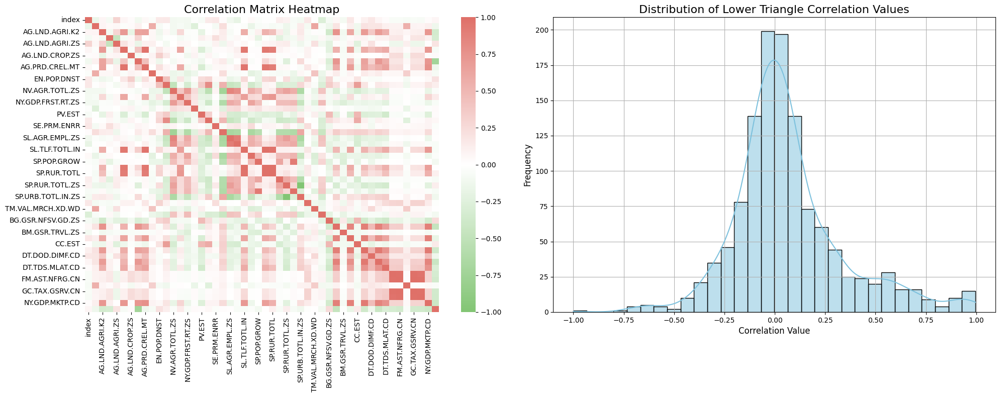

In [26]:
# Define a custom color gradient
custom_cmap = LinearSegmentedColormap.from_list(
    "custom_gradient",
    ["#82C574", "#FFFFFF", "#DF7068"]
)

# Create side-by-side plots
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

# Plot the heatmap on the first subplot
sns.heatmap(
    preProceedData2.select_dtypes(include=['number']).corr(),
    cmap=custom_cmap,
    annot=False,
    vmin=-1,
    vmax=1,
    #mask=mask,
    ax=axes[0]
)
axes[0].set_title('Correlation Matrix Heatmap', fontsize=16)

# Plot the distribution on the second subplot
sns.histplot(
    lower_triangle_values,
    bins=30,
    kde=True,
    color='#7DC1DD',
    ax=axes[1]
)
axes[1].set_title('Distribution of Lower Triangle Correlation Values', fontsize=16)
axes[1].set_xlabel('Correlation Value', fontsize=12)
axes[1].set_ylabel('Frequency', fontsize=12)
axes[1].grid(True)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

Identify pairs of variables with high correlations (≥ 0.9 or ≤ -0.9), which indicate potential multicollinearity. Using the masked lower triangle of the correlation matrix, it iterates through variable pairs to extract those meeting the threshold. These pairs, along with their correlation values, are stored in a list and converted into a DataFrame (high_correl) for better visualization and analysis. This helps in pinpointing strongly correlated variables that may need to be excluded or handled in modeling.

In [27]:
# Identify correlations >= 0.9 or <= -0.9
high_corr = corr[(corr >= 0.9) | (corr <= -0.9)]

# Get the column names of high_corr
high_corr_columns = high_corr.index

# Apply the mask to keep only the lower triangle
corr_masked = corr.where(~mask)

# Identify correlations >= 0.9 or <= -0.9 in the lower triangle
high_corr_pairs = []
for i in corr_masked.index:
    for j in corr_masked.columns:
        if not pd.isna(corr_masked.loc[i, j]) and ((corr_masked.loc[i, j] >= 0.9) or (corr_masked.loc[i, j] <= -0.9)):
            high_corr_pairs.append((i, j, corr_masked.loc[i, j]))

# Convert to a DataFrame for better visualization
high_correl = pd.DataFrame(high_corr_pairs, columns=['Variable 1', 'Variable 2', 'Correlation'])

Enriches the highly correlated variable pairs (high_correl) by merging them with the codeDescription DataFrame to replace variable codes with their human-readable descriptions. Each variable pair is processed separately, renaming and organizing columns for clarity. The final DataFrame, high_corr_df, presents the pairs with their descriptive names and correlation values.

In [28]:
# Merge the two dataframes for variable 1
high_corr_var1 = pd.merge(
    high_correl,
    codeDescription,
    left_on='Variable 1',
    right_on='Variable',
    how='left'
)

high_corr_var1 = high_corr_var1.drop(columns=['Variable','Variable 1'])

# Rename a column in the dataframe
high_corr_var1.rename(columns={'Description': 'Variable 1'}, inplace=True)

# Merge the two dataframes for variable 2
high_corr_df = pd.merge(
    high_corr_var1,
    codeDescription,
    left_on='Variable 2',
    right_on='Variable',
    how='left'
)

high_corr_df = high_corr_df.drop(columns=['Variable','Variable 2'])

# Rename a column in the dataframe
high_corr_df.rename(columns={'Description': 'Variable 2'}, inplace=True)

high_corr_df = high_corr_df[['Variable 1', 'Variable 2', 'Correlation']]

# Display the result
high_corr_df.round(2)

,Variable 1,Variable 2,Correlation
0,Cereal production (metric tons),Arable land (hectares),0.97
1,"Self-employed, total (% of total employment) (...",Employment in agriculture (% of total employme...,0.90
2,"Labor force, total",Arable land (hectares),0.94
3,"Labor force, total",Cereal production (metric tons),0.96
4,"Population, total",Arable land (hectares),0.94
5,"Population, total",Cereal production (metric tons),0.95
6,"Population, total","Labor force, total",1.00
7,Rural population,Arable land (hectares),0.91
8,Rural population,Cereal production (metric tons),0.90
9,Rural population,"Labor force, total",0.97


Aggregate the variables from highly correlated pairs to identify which variables are most frequently involved in strong correlations. It combines Variable 1 and Variable 2 into a single series, counts their occurrences, and converts the result into a DataFrame (variable_counts_df) for better visualization. This highlights variables that are repeatedly involved in multicollinearity, helping to prioritize them for further investigation or potential exclusion from the analysis.

In [29]:
# Combine Variable 1 and Variable 2 into a single series
all_variables = pd.concat([high_corr_df['Variable 1'], high_corr_df['Variable 2']])

# Count the occurrences of each variable
variable_counts = all_variables.value_counts()

# Convert to a DataFrame for better visualization
variable_counts_df = variable_counts.reset_index()
variable_counts_df.columns = ['Variable', 'Count']

# Display the result
variable_counts_df

,Variable,Count
0,Cereal production (metric tons),4
1,"Labor force, total",4
2,"Population, total",4
3,Rural population,4
4,Arable land (hectares),4
5,Net foreign assets (current LCU),3
6,Subsidies and other transfers (current LCU),3
7,Taxes on goods and services (current LCU),3
8,Net domestic credit (current LCU),3
9,"External debt stocks, total (DOD, current US$)",2


To address multicollinearity issues in the dataset, specific variables have been selected for exclusion based on their strong correlations with others. These variables, listed in corrExclude, are removed to reduce redundancy and improve the reliability and interpretability of subsequent analyses. This decision ensures that the remaining variables provide unique and meaningful contributions to the models and analyses.

In [30]:
# Decide to exclude some variables in response of collinearity issue
corrExclude = ['AG.PRD.CREL.MT',
'DT.DOD.DECT.CD',
'FM.AST.NFRG.CN',
'GC.TAX.GSRV.CN',
'SL.EMP.SELF.ZS',
'BX.GSR.GNFS.CD',
'DT.DOD.DECT.CD',
'FM.AST.DOMS.CN',
'FM.AST.NFRG.CN',
'GC.TAX.GSRV.CN',
'SP.RUR.TOTL.ZS',
]

Enriches the dataset by adding additional categorical information. The filtered allCountry DataFrame, containing region and incomeLevel data, is merged with the cleaned data (preProceedData2) based on country names.

In [31]:
#Additional categorical data
#Select only the required columns
allCountryFiltered = allCountry[['name', 'region', 'incomeLevel']]

additionalMerged = pd.merge(preProceedData2, allCountryFiltered, left_on=['Country'], right_on=['name'], how='inner')

Identify variables to exclude from the dataset by combining two exclusion lists: corrExclude, which contains variables removed due to multicollinearity, and specific_excludes, which includes columns not relevant for analysis (e.g., identifiers like ID and name).

In [32]:
# Columns to exclude from preProceedData2
specific_excludes = ['index', 'ID', 'AG.LND.FRST.K2','name']

# Combine corrExclude with specific columns to exclude
variableXExclude = list(set(corrExclude + specific_excludes))

Creates a cleaned dataset, ensuring that redundant, irrelevant, or highly correlated variables are excluded, leaving a refined dataset ready for further analysis or modeling.

In [33]:
dataForRf = additionalMerged[[col for col in additionalMerged.columns if col not in variableXExclude]]
dataForRf.round(1)

,Country,year,AG.LND.AGRI.K2,AG.LND.FRST.ZS,AG.LND.AGRI.ZS,AG.LND.ARBL.HA,AG.LND.CROP.ZS,AG.PRD.CROP.XD,EN.POP.DNST,GE.EST,NV.AGR.TOTL.ZS,NY.ADJ.DFOR.CD,NY.GDP.FRST.RT.ZS,NY.GDP.MKTP.KD.ZG,PV.EST,RQ.EST,SE.PRM.ENRR,SE.SEC.ENRR,SL.AGR.EMPL.ZS,SL.TLF.TOTL.IN,SN.ITK.DEFC.ZS,SP.POP.GROW,SP.POP.TOTL,SP.RUR.TOTL,SP.RUR.TOTL.ZG,SP.URB.GROW,SP.URB.TOTL.IN.ZS,TM.VAL.AGRI.ZS.UN,TM.VAL.MRCH.XD.WD,TX.VAL.AGRI.ZS.UN,BG.GSR.NFSV.GD.ZS,BM.GSR.FCTY.CD,BM.GSR.TRVL.ZS,CC.EST,DT.DOD.DIMF.CD,DT.TDS.DECT.CD,DT.TDS.MLAT.CD,FP.CPI.TOTL,GC.XPN.TRFT.CN,NY.GDP.MKTP.CD,Deforestation,region,incomeLevel
0,Albania,2003,11210.0,28.2,40.9,578000.0,4.4,54.9,110.9,-0.6,22.0,3535170.7,0.1,5.5,-0.3,-0.5,107.6,77.8,48.0,1290479.0,7.4,-0.4,3039616.0,1684768.0,-2.3,2.1,44.6,1.0,43.3,5.1,27.6,2.436447e+07,60.9,-0.9,1.594152e+08,5.727977e+07,2.021326e+07,82.8,5.728388e+10,5.611496e+09,12.8,ECS,UMC
1,Albania,2004,11220.0,28.3,40.9,578000.0,4.4,58.5,110.5,-0.4,20.5,3879499.9,0.1,5.5,-0.4,-0.2,104.1,79.0,47.6,1275704.0,8.6,-0.4,3026939.0,1645111.0,-2.4,2.0,45.7,1.1,53.7,4.5,30.0,2.832284e+07,60.8,-0.7,1.690999e+08,7.602167e+07,2.783090e+07,84.7,7.013519e+10,7.184686e+09,12.8,ECS,UMC
2,Albania,2011,12010.0,28.6,43.8,622000.0,2.7,87.4,106.0,-0.2,18.2,27102197.8,0.2,2.5,-0.3,0.3,101.6,95.5,45.4,1376967.0,4.8,-0.3,2905195.0,1358266.0,-2.6,1.8,53.2,1.0,125.4,2.6,39.3,2.986859e+08,69.6,-0.7,1.172413e+08,4.825108e+08,8.207203e+07,103.4,1.358977e+11,1.289076e+10,90.9,ECS,UMC
3,Albania,2012,12013.0,28.6,43.8,619100.0,2.8,93.9,105.9,-0.3,18.8,22486375.5,0.2,1.4,-0.1,0.2,102.1,97.6,46.0,1317523.0,4.5,-0.2,2900401.0,1324613.0,-2.5,1.8,54.3,0.9,113.5,2.5,34.9,3.329938e+08,68.6,-0.8,1.070361e+08,5.425489e+08,8.957130e+07,105.5,1.399201e+11,1.231983e+10,14.2,ECS,UMC
4,Albania,2013,11873.0,28.7,43.3,617100.0,2.9,93.7,105.7,-0.3,19.6,21100579.4,0.2,1.0,0.1,0.3,101.5,102.9,44.2,1217209.0,4.4,-0.2,2895092.0,1291587.0,-2.5,1.7,55.4,1.0,113.9,2.3,33.4,1.504106e+08,74.7,-0.8,9.675547e+07,5.504619e+08,1.013739e+08,107.6,1.517697e+11,1.277622e+10,14.2,ECS,UMC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
604,Ukraine,2017,414890.0,16.7,71.6,32773000.0,1.5,100.8,78.4,-0.5,10.2,0.0,0.4,2.4,-1.9,-0.3,88.2,86.8,15.4,21646826.0,2.6,-0.4,45436041.0,13973400.0,-0.7,-0.3,69.2,1.2,132.2,1.7,24.6,7.691000e+09,53.4,-0.8,1.400143e+10,1.322454e+10,2.139854e+09,235.3,6.123422e+11,1.120905e+11,70.0,ECS,UMC
605,Ukraine,2018,413290.0,16.7,71.3,32889000.0,1.5,111.1,78.0,-0.5,10.1,0.0,0.4,3.5,-1.9,-0.3,88.6,85.8,15.3,21532913.0,3.0,-0.5,45208907.0,13855626.0,-0.8,-0.3,69.4,1.1,152.4,2.0,23.2,1.058100e+10,54.5,-0.9,1.299723e+10,1.476636e+10,2.223670e+09,261.1,7.081612e+11,1.308911e+11,70.0,ECS,UMC
606,Ukraine,2019,413110.0,16.7,71.3,32924000.0,1.5,112.8,77.6,-0.3,9.0,0.0,0.3,3.2,-1.4,-0.2,90.7,84.5,15.2,21427949.0,3.7,-0.6,44957458.0,13724163.0,-1.0,-0.4,69.5,1.0,162.1,1.7,21.6,1.137100e+10,54.2,-0.8,1.132839e+10,1.395323e+10,1.250666e+09,281.7,7.612929e+11,1.538830e+11,60.0,ECS,UMC
607,Ukraine,2020,413110.0,16.7,71.3,32924000.0,1.5,100.9,77.1,-0.4,9.3,0.0,0.3,-3.8,-1.2,-0.3,91.1,84.4,15.3,20852330.0,4.3,-0.6,44680014.0,13579150.0,-1.1,-0.4,69.6,1.1,144.8,1.7,17.1,8.629000e+09,42.0,-0.8,1.282442e+10,1.739990e+10,1.304253e+09,289.4,8.467340e+11,1.566177e+11,60.0,ECS,UMC


# RandomForest

## Data preparation for modeling




Split the refined dataset dataForRf into two subsets: 70% for training (train_set) and 30% for testing (test_set). The random_state=42 ensures reproducibility, allowing the same split to be generated each time.

In [34]:
# Split the data 70/30
train_set, test_set = train_test_split(dataForRf, test_size=0.3, random_state=42)

Define the target variable for the model, which is "Deforestation." The Deforestation column is extracted separately from the training (y_train) and testing (y_test) datasets.

In [35]:
# the target labels: log of Deforestation
y_train = train_set["Deforestation"]
y_test = test_set["Deforestation"]

Prepare the features for modeling by separating them into numerical and categorical variables. First, the target variable Deforestation is dropped from the dataset (dropDefo) to focus only on predictors. The remaining columns are divided based on their data type: num_cols contains numerical features, and cat_cols contains categorical features.

In [36]:
dropDefo = dataForRf.drop(columns=["Deforestation"])

# Divide data by type
num_cols = sorted(dropDefo.select_dtypes(include=['int64', 'float64']).columns.tolist())
cat_cols = sorted(dropDefo.select_dtypes(include=['object']).columns.tolist())

print(f'There are {len(cat_cols)} categorical variables')
print(f'There are {len(num_cols)} numerical variables')

There are 3 categorical variables
There are 39 numerical variables


Set up a preprocessing pipeline using a ColumnTransformer to handle both numerical and categorical features. Numerical columns (num_cols) are scaled with StandardScaler to normalize their values, while categorical columns (cat_cols) are encoded into binary format using OneHotEncoder, which creates a new binary column for each unique category. The processed feature sets, X_train and X_test, are extracted from the training and testing datasets.

In [37]:
# Set up the column transformer with two transformers
# ----> Scale the numerical columns
# ----> One-hot encode the categorical columns

transformer = ColumnTransformer(
    transformers=[
        ("num", StandardScaler(), num_cols),
        ("cat", OneHotEncoder(handle_unknown="ignore"), cat_cols),
    ]
)

X_train = train_set[num_cols + cat_cols]
X_test = test_set[num_cols + cat_cols]

## Pipeline

Initialize a machine learning pipeline combining data preprocessing and modeling. The transformer handles feature preprocessing (scaling numerical features and one-hot encoding categorical features), while the RandomForestRegressor is the chosen model for regression tasks.

In [38]:
# Initialize the pipeline
pipe = make_pipeline(
    transformer, RandomForestRegressor(n_estimators=10,
                                       random_state=42)
)

## Base Random Forest Model



Train the machine learning pipeline by fitting it to the training data (train_set) and the target labels (y_train). The pipeline automatically applies preprocessing (scaling and encoding) to the features and then trains the RandomForestRegressor model on the processed data.

In [39]:
# Fit the training set
pipe.fit(train_set, y_train);

Evaluate the performance of the trained pipeline on the testing dataset. The pipe.score method computes the R² (coefficient of determination) score, which measures how well the model's predictions match the actual target values (y_test). An R² score close to 1 indicates a strong predictive performance, while lower values suggest areas for improvement.

In [40]:
# What's the test score?
pipe.score(test_set, y_test)

0.6748279503793474

In [41]:
testscore1 = pipe.score(test_set, y_test)

## Feature importance



Feature importance is computed to identify the most significant variables contributing to deforestation.

Retrieve the names of the transformed features after one-hot encoding. The one-hot encoder (ohe) within the pipeline is accessed to obtain the generated binary columns (ohe_cols) for categorical variables. These are combined with the original numerical column names (num_cols) to create a comprehensive list of feature names (features).

In [42]:
# The one-hot step
ohe = transformer.named_transformers_['cat']

# One column for each category type!
ohe_cols = ohe.get_feature_names_out()

# Full list of columns is numerical + one-hot
features = num_cols + list(ohe_cols)

Calculate the importance of each feature in the RandomForestRegressor. The trained random forest model is accessed from the pipeline (random_forest), and its feature_importances_ attribute provides the relative contribution of each feature to the model's predictions. These importance values are combined with the feature names (features) into a DataFrame (importance).

In [43]:
random_forest = pipe["randomforestregressor"]

# Create the dataframe with importances
importance = pd.DataFrame(
    {"Feature": features, "Importance": random_forest.feature_importances_}
)

### Visualization of feature importance

The importance DataFrame is merged with codeDescription to map each feature to its corresponding description. If a description is unavailable, the original feature name is retained. The resulting DataFrame, importanceResult, contains only the feature descriptions and their importance scores.

In [44]:
# Change code to description
importanceResult = pd.merge(
    importance,
    codeDescription,
    left_on='Feature',
    right_on='Variable',
    how='left'
)

importanceResult = importanceResult.drop(columns=['Variable'])
importanceResult['Description'] = importanceResult['Description'].fillna(importanceResult['Feature'])
importanceResult = importanceResult.drop(columns=['Feature'])

Visualize the top 20 most important features in the Random Forest model using a bar chart. The importanceResult DataFrame is sorted by the Importance column in descending order, and the top 20 features are selected. Altair is used to create a bar chart where the x-axis represents feature importance, and the y-axis lists feature descriptions sorted by their importance. Tooltips provide additional detail, and the chart is styled with a clear title and appropriate dimensions.

In [45]:
# Sort the data and select the top 50 features
top_features = importanceResult.sort_values("Importance", ascending=False).round(5).head(20)

# Create the Feature Importance plot using Altair
feature_importance_chart = alt.Chart(top_features).mark_bar().encode(
    x=alt.X("Importance:Q", title="Importance"),
    y=alt.Y("Description:N", sort='-x', title="Descriptions"),
    tooltip=["Description:N", "Importance:Q"]
).properties(
    title="Top 20 Feature Importance Plot",
    width=600,
    height=400
).configure_title(
    fontSize=16,
    anchor='middle'
)

feature_importance_chart.show()

alt.Chart(...)

Evaluate the pipeline's performance using 3-fold cross-validation. The dataset is split into three subsets, and the model is trained and tested on different combinations of these subsets to calculate R² scores (scores). These scores measure how well the model explains the variance in the target variable. The mean (scores.mean()) and standard deviation (scores.std()) of the scores are calculated to summarize the model's overall performance and consistency across the folds.

In [46]:
# Run the 3-fold cross validation
scores = cross_val_score(
    pipe,
    X_train,
    y_train,
    cv=3,
)

# Copy
scores1 = scores
scoresmean1 = scores.mean
scoresstd1 = scores.std


# Report
print("R^2 scores = ", scores)
print("Scores mean = ", scores.mean())
print("Score std dev = ", scores.std())

R^2 scores =  [0.85363655 0.71871286 0.55555343]
Scores mean =  0.7093009488161712
Score std dev =  0.12187377264188007


# Optimization


Hyperparameters like the number of estimators and maximum tree depth are tuned using GridSearchCV.

Create a regression pipeline (pipeGridSearch) designed for hyperparameter optimization. It combines the transformer, which preprocesses the data (scaling numerical features and one-hot encoding categorical ones), with a RandomForestRegressor.

In [47]:
# Create our regression pipeline
pipeGridSearch = make_pipeline(transformer, RandomForestRegressor(random_state=42))

Hyperparameter grid (param_grid) for tuning the RandomForestRegressor within the pipeline.

These hyperparameters will be systematically tested using methods like GridSearchCV to identify the optimal combination that improves the model's performance. The prefix randomforestregressor__ links the parameters to the specific model in the pipeline.

In [48]:
model_step = "randomforestregressor"
param_grid = {
    f"{model_step}__n_estimators": [5, 10, 15, 20, 30, 50, 100, 200],
    f"{model_step}__max_depth": [2, 5, 7, 9, 13, 21, 33, 51],
}

## GridSearchCV

The grid search systematically tests all combinations of the hyperparameters defined in param_grid by training the model with 3-fold cross-validation (cv=3) for each combination. The grid.fit method trains the pipeline (pipeGridSearch) on the training data (train_set, y_train) to identify the best-performing hyperparameter settings. The verbose=1 option provides progress updates during the search process.

In [49]:
# Create the grid and use 3-fold CV
grid = GridSearchCV(pipeGridSearch, param_grid, cv=3, verbose=1)

# Run the search
grid.fit(train_set, y_train)

Fitting 3 folds for each of 64 candidates, totalling 192 fits


GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('columntransformer',
                                        ColumnTransformer(transformers=[('num',
                                                                         StandardScaler(),
                                                                         ['AG.LND.AGRI.K2',
                                                                          'AG.LND.AGRI.ZS',
                                                                          'AG.LND.ARBL.HA',
                                                                          'AG.LND.CROP.ZS',
                                                                          'AG.LND.FRST.ZS',
                                                                          'AG.PRD.CROP.XD',
                                                                          'BG.GSR.NFSV.GD.ZS',
                                                                          'BM.GSR.FCTY.CD',
                                                                          'BM.GSR.TRVL.ZS',
                                                                          'CC.EST',
                                                                          'DT.DOD.DIMF.CD',
                                                                          'DT.TDS.DECT.CD',
                                                                          'DT.TDS.MLAT.CD',
                                                                          'EN.POP.DNST...
                                                                          'SL.TLF.TOTL.IN',
                                                                          'SN.ITK.DEFC.ZS',
                                                                          'SP.POP.GROW', ...]),
                                                                        ('cat',
                                                                         OneHotEncoder(handle_unknown='ignore'),
                                                                         ['Country',
                                                                          'incomeLevel',
                                                                          'region'])])),
                                       ('randomforestregressor',
                                        RandomForestRegressor(random_state=42))]),
             param_grid={'randomforestregressor__max_depth': [2, 5, 7, 9, 13,
                                                              21, 33, 51],
                         'randomforestregressor__n_estimators': [5, 10, 15, 20,
                                                                 30, 50, 100,
                                                                 200]},
             verbose=1)

grid.best_estimator_: Displays the pipeline with the best combination of hyperparameters, which achieved the highest performance during cross-validation. grid.best_params_: Shows the specific hyperparameter values (e.g., n_estimators and max_depth) that resulted in the best model performance.

In [50]:
# The best estimator
grid.best_estimator_

# The best hyper parameters
grid.best_params_

{'randomforestregressor__max_depth': 13,
 'randomforestregressor__n_estimators': 50}

The model (best_model) predicts the target values (y_pred) for the test set (X_test), and its performance is measured using the R² score, which assesses how well the model explains the variance in the actual target values (y_test). The results include the average cross-validation score during training (grid.best_score_) and the R² score on the testing data.

In [51]:
# Compute recall score on the testing set using the best model
best_model = grid.best_estimator_
y_pred = best_model.predict(X_test)
search_score = r2_score(y_test, y_pred)
testscore2 = search_score

print(f'The best model achieves an average cross-validation score of {grid.best_score_*100:.2f}%')
print(f'The best model achieves a r2 score of {search_score*100:.2f}% on the testing data')

The best model achieves an average cross-validation score of 73.78%
The best model achieves a r2 score of 67.43% on the testing data


3-fold cross-validation to evaluate the performance of the pipeline (pipeGridSearch) on the training data (X_train and y_train). It splits the data into three subsets, trains the model on two subsets, and tests it on the third, repeating this process for all folds. The R² scores from each fold are recorded, and their mean and standard deviation are calculated to summarize the model’s overall performance and consistency.

In [52]:
# Run the 3-fold cross validation
scores = cross_val_score(
    pipeGridSearch,
    X_train,
    y_train,
    cv=3,
)

# Copy
scores2 = scores
scoresmean2 = scores.mean
scoresstd2 = scores.std

# Report
print("R^2 scores = ", scores)
print("Scores mean = ", scores.mean())
print("Score std dev = ", scores.std())

R^2 scores =  [0.86553356 0.74053747 0.56055631]
Scores mean =  0.7222091138420561
Score std dev =  0.1251791455131474


### Visualization of accuracy comparison

Compare the performance of the initial and optimized models by summarizing their R² scores from cross-validation and testing. The scores for each fold, along with the mean and test scores, are recorded for both models. The data is structured into a DataFrame (slope_df) to prepare for visualization, highlighting the performance improvements achieved through hyperparameter optimization using GridSearchCV.

In [53]:
# Comparing before and after optimization using GridSearchCV
# Data for initial model
initial_cv_scores = scores1
initial_mean = scoresmean1()
initial_std = scoresstd1()
initial_test_score = testscore1

# Data for optimized model
optimized_cv_scores = scores2
optimized_mean = scoresmean2()
optimized_std = scoresstd2()
optimized_test_score = testscore2

# Data for the slope graph
metrics = ['Fold 1', 'Fold 2', 'Fold 3', 'Mean', 'Test Score']
initial_scores = initial_cv_scores.tolist() + [initial_mean, initial_test_score]
optimized_scores = optimized_cv_scores.tolist() + [optimized_mean, optimized_test_score]

# Prepare the data for the slope graph
slope_data = {
    'Metric': metrics * 2,  # Repeat metrics for 'Initial' and 'Optimized'
    'Score': initial_scores + optimized_scores,
    'Model': ['Initial'] * len(metrics) + ['Optimized'] * len(metrics)
}

# Convert to DataFrame
slope_df = pd.DataFrame(slope_data)

Visualize the comparison between the initial and optimized models using a slope graph created with Altair. The chart displays R² scores for each metric (e.g., folds, mean, and test score) as lines connecting the initial and optimized models, making it easy to observe performance improvements. Custom colors are used to differentiate metrics, and tooltips provide detailed information on scores and models.

In [54]:
# Create chart
# Define custom colors for each metric
custom_colors = {
    'Fold 1': '#82C574',
    'Fold 2': '#EB9E42',
    'Fold 3': '#DF7068',
    'Mean': '#7DC1DD',
    'Test Score': '#3F597C'
}

# Create the slope graph
slope_chart = alt.Chart(slope_df).mark_line(point=alt.MarkConfig(size=100)).encode(
    x=alt.X('Model:N', title='', axis=alt.Axis(labels=True, labelAngle=0)),
    y=alt.Y('Score:Q', title='R² Score', scale=alt.Scale(domain=[0.5, 1])),
    color=alt.Color('Metric:N', scale=alt.Scale(domain=list(custom_colors.keys()), range=list(custom_colors.values()))),
    detail='Metric:N',
    tooltip=['Metric:N', 'Score:Q', 'Model:N']
).properties(
    title="R² Score: Initial vs Optimized (GridSearchCV) Model",
    width=400,
    height=300
).configure_title(
    fontSize=16,
    anchor='middle'
).configure_axis(
    labelFontSize=12,
    titleFontSize=14
)

slope_chart.show()

alt.Chart(...)

## Comparison of Tested vs. Predicted Deforestation

### Visualization of y test and y prediction

Altair visualizations are created to compare actual deforestation trends (y_test) with model predictions (y_pred). A shared brush selection allows users to focus on specific countries.

A new DataFrame, predVis, is created to store predictions along with associated metadata, such as year, Country, and region. The region_full column maps region abbreviations to their full names for clarity. Similarly, the actual deforestation values are combined with their corresponding metadata in mergeXYTest.

In [55]:
# Visualization: Comparing between actual vs prediction
predVis = pd.DataFrame({'Predictions': y_pred})
predVis['year'] = X_test['year'].reset_index(drop=True)
predVis['Country'] = X_test['Country'].reset_index(drop=True)
predVis['region'] = X_test['region'].reset_index(drop=True)
predVis['region_full'] = predVis['region'].map(region_mapping)

dfYTest = pd.DataFrame(y_test)
X_test_index = X_test.reset_index()
dfYTest = dfYTest.reset_index()
mergeXYTest = pd.merge(dfYTest, X_test_index, on='index')
mergeXYTest = mergeXYTest[['Deforestation', 'Country', 'year', 'region']]
mergeXYTest['region_full'] = mergeXYTest['region'].map(region_mapping)

Create a side-by-side comparison of observed (y_test) and predicted (y_pred) deforestation trends using Altair. Two bar charts are generated: one for reported deforestation (mergeXYTest) and another for predicted values (predVis). Both charts are grouped by year and colored by regions, with custom colors and tooltips providing additional details. A shared brush selection allows users to click on a specific country to highlight its data in both charts simultaneously. The charts are combined horizontally to visualize actual versus predicted trends side-by-side.

In [56]:
# Define custom colors
customColor = ['#7DC1DD', '#EB9E42', '#DF7068', '#82C574', '#82888D', '#3F597C']

# Shared brush selection for both charts
shared_brush = alt.selection_point(fields=['Country'], on='click', name='shared')

# Plot 1: Reported Deforestation
deforestation_chart = alt.Chart(mergeXYTest).mark_bar(stroke='white', strokeWidth=0.5).encode(
    x=alt.X('year:O', title='Year'),
    y=alt.Y('sum(Deforestation):Q', title='Change in Forest Area, sq. km (Negative = forest loss)'),
    color=alt.condition(
        shared_brush,
        alt.Color("region_full:N", scale=alt.Scale(range=customColor), legend=alt.Legend(title="Region", orient="bottom-left")),
        alt.value('lightgray')
    ),
    tooltip=['Country', 'year', 'Deforestation', 'region_full']
).add_params(
    shared_brush
).properties(
    title='Observed Deforestation (y_test)',
    width=400,
    height=300
)

# Plot 2: Predicted Deforestation
predDefoChart = alt.Chart(predVis).mark_bar(stroke='white', strokeWidth=0.5).encode(
    x=alt.X('year:O', title='Year'),
    y=alt.Y('sum(Predictions):Q', title='Change in Forest Area, sq. km (Negative = forest loss)'),
    color=alt.condition(
        shared_brush,
        alt.Color("region_full:N", scale=alt.Scale(range=customColor), legend=alt.Legend(title="Region", orient="bottom-left")),
        alt.value('lightgray')
    ),
    tooltip=['Country', 'year', 'Predictions', 'region_full']
).add_params(
    shared_brush
).properties(
    title='Predicted Deforestation (y_pred)',
    width=400,
    height=300
)

# Combine charts horizontally
combined_chart = alt.hconcat(
    deforestation_chart,
    predDefoChart
).properties(
    title="Comparison"
).configure_legend(
    orient='bottom-left',
    titleFontSize=12,
    labelFontSize=10,
    fillColor='white'
).configure_title(
    fontSize=16,
    anchor='middle',
    color='black'
)

# Show the combined chart
combined_chart

alt.HConcatChart(...)

## Residual analysis



Residuals (differences between actual and predicted values) are analyzed to check for systematic biases in the model.

The residuals are stored in a new DataFrame, yResidual, providing insight into the errors made by the model. A copy of this DataFrame, yResidualVis, is created for visualization, and it includes the predicted values alongside the residuals to help analyze patterns and identify systematic biases in the model's predictions.


In [57]:
# Calculate residuals
yResidual = pd.DataFrame()
yResidual['Residuals'] = mergeXYTest['Deforestation'] - predVis['Predictions']

# Create dataframe for visualization
yResidualVis = yResidual.copy()
yResidualVis['Predictions'] = predVis['Predictions']

### Visualization of residual

Create a residual plot to evaluate the performance of the regression model. Using Seaborn's scatterplot, it plots predicted values (Predictions) on the x-axis and residuals (Residuals) on the y-axis. A horizontal dashed line at y=0 is added as a reference, showing where residuals would indicate perfect predictions. The plot is styled with titles, labels, and a grid for clarity. Randomly scattered residuals around the zero line suggest the model performs well.

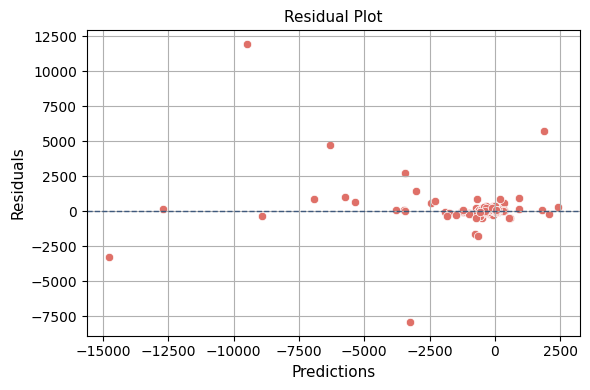

In [58]:
# Create a scatter plot for residuals
fig, axes = plt.subplots(1, 1, figsize=(6, 4))

# Create a scatter plot of residuals
sns.scatterplot(
    data=yResidualVis,
    x='Predictions',  # X-axis as index of residuals
    y='Residuals',  # Residuals on the Y-axis
    color='#DF7068',
    ax=axes
)
axes.axhline(0, color='#3F597C', linestyle='--', linewidth=1)  # Add a horizontal line at 0
axes.set_title('Residual Plot', fontsize=11)
axes.set_xlabel('Predictions', fontsize=11)
axes.set_ylabel('Residuals', fontsize=11)
axes.grid(True)

# Show the plot
plt.tight_layout()
plt.show()